## Implementation of 
# NEURAL NETWORK HYPERSPECTRAL UNMIXING WITH SPECTRAL INFORMATION DIVERGENCE OBJECTIVE*

F. Palsson, J. Sigurdsson, J. R. Sveinsson and M. O. Ulfarsson, "Neural network hyperspectral unmixing with spectral information divergence objective," 2017 IEEE International Geoscience and Remote Sensing Symposium (IGARSS), 2017, pp. 755-758, doi: 10.1109/IGARSS.2017.8127062.

### Imports

In [1]:
import tensorflow as tf
from tensorflow.keras import initializers, constraints, layers, activations, regularizers
from tensorflow.python.ops import math_ops
from tensorflow.python.keras import backend as K
from tensorflow.python.framework import tensor_shape
from unmixing import HSI, plotEndmembers,SAD
from unmixing import plotEndmembersAndGT, plotAbundancesSimple, load_HSI, PlotWhileTraining
from scipy import io as sio
import os
import numpy as np
from numpy.linalg import inv
import warnings
import matplotlib

warnings.filterwarnings("ignore")
%matplotlib inline

### Use CPU

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

## Class SparseReLU
Performs dynamic thresholding of abundances.

In [3]:
class SparseReLU(tf.keras.layers.Layer):
    def __init__(self,params):
        self.params=params
        super(SparseReLU, self).__init__()
        self.alpha = self.add_weight(shape=(self.params['num_endmembers'],),initializer=tf.keras.initializers.Zeros(),
        trainable=True, constraint=tf.keras.constraints.non_neg())
    def build(self, input_shape):
        self.alpha = self.add_weight(shape=input_shape[1:],initializer=tf.keras.initializers.Zeros(),
        trainable=True, constraint=tf.keras.constraints.non_neg())
        super(SparseReLU, self).build(input_shape)
    def call(self, x):
        return tf.keras.backend.relu(x - self.alpha)


## Class SumToOne
Performs abundance normalization to enforce ASC

In [4]:
class SumToOne(layers.Layer):
    def __init__(self, **kwargs):
        super(SumToOne, self).__init__(**kwargs)
        
    def call(self, x):
        x *= K.cast(x >= K.epsilon(), K.floatx())
        x = K.relu(x)
        x = x/(K.sum(x, axis=-1, keepdims=True)+K.epsilon())
        return x

## SID Loss function implementation

In [5]:
def SID(y_true, y_pred):
    y_true = K.switch(K.min(y_true) < 0, y_true - K.min(y_true) + K.epsilon(), y_true + K.epsilon())
    y_pred = K.switch(K.min(y_pred) < 0, y_pred - K.min(y_pred) + K.epsilon(), y_pred + K.epsilon())

    p_n = y_true / K.sum(y_true, axis=1, keepdims=True)
    q_n = y_pred / K.sum(y_pred, axis=1, keepdims=True)
    return K.sum(p_n * K.log(p_n / q_n)) + K.sum(q_n * K.log(q_n / p_n))


## Class Autoencoder
Wrapper class for the autoencoder model and associcated utility functions

In [6]:
class Autoencoder(object):
    def __init__(self, params):
        self.data = params["data"].array()
        self.params = params
        self.decoder = layers.Dense(
            units=self.params["n_bands"],
            kernel_regularizer=None,
            activation="linear",
            name="output",
            use_bias=False,
            kernel_constraint=constraints.non_neg()
        )
        self.hidden = layers.Dense(
            units=self.params["num_endmembers"],
            activation='linear',
            name='hidden1',
            use_bias=False
        )
        self.sparseReLU = SparseReLU(params)
        self.asc_layer = SumToOne(name='abundances')
        self.model = self.create_model()
        self.model.compile(optimizer=self.params["optimizer"], loss=self.params["loss"])
        
    def create_model(self):
        input_features = layers.Input(shape=(self.params["n_bands"],))
        code = self.hidden(input_features)
        code = layers.BatchNormalization()(code)
        code = self.sparseReLU(code)
        abunds = self.asc_layer(code)
        output = self.decoder(abunds)

        return tf.keras.Model(inputs=input_features, outputs=output)
        
    
    def fit(self,data,n):
        plot_callback = PlotWhileTraining(n,self.params['data'])
        return self.model.fit(
            x=data,
            y=data,
            batch_size=self.params["batch_size"],
            epochs=self.params["epochs"],
            callbacks=[plot_callback]
        )

    def get_endmembers(self):
        return self.model.layers[len(self.model.layers) - 1].get_weights()[0]

    def get_abundances(self):
        intermediate_layer_model = tf.keras.Model(
            inputs=self.model.input, outputs=self.model.get_layer("abundances").output
        )
        abundances = intermediate_layer_model.predict(self.data)
        abundances = np.reshape(abundances,[self.params['data'].cols,self.params['data'].rows,self.params['num_endmembers']])
        
        return abundances

## Set Hyperparameters and load data

In [7]:
#Dictonary of aliases for datasets. The first string is the key and second is value (name of matfile without .mat suffix)
#Useful when looping over datasets
datasetnames = {"Urban": "Urban4"
}

dataset = "Urban"

hsi = load_HSI(
datasetnames[dataset] + ".mat"
)

# Hyperparameters
num_endmembers = 4
num_spectra = 2000
batch_size = 5
learning_rate = 0.001
epochs = 40
loss = SID
opt = tf.optimizers.RMSprop(learning_rate=learning_rate)

data = hsi.array()

# Hyperparameter dictionary
params = {
    "num_endmembers": num_endmembers,
    "batch_size": batch_size,
    "num_spectra": num_spectra,
    "data": hsi,
    "epochs": epochs,
    "n_bands": hsi.bands,
    "GT": hsi.gt,
    "lr": learning_rate,
    "optimizer": opt,
    "loss": loss,
}

plot_every = 0 #Plot endmembers and abundance maps every x epochs. Set to 0 when running experiments. 

training_data = data[
    np.random.randint(0, data.shape[0], num_spectra), :
]


## Train Autoencoder

Epoch 1/40
400/400 [==============================] - 1s 999us/step - loss: 2.0703
Epoch 2/40
400/400 [==============================] - 0s 960us/step - loss: 1.0324
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.9929
Epoch 4/40
400/400 [==============================] - 0s 947us/step - loss: 0.8914
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.7877
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.7014
Epoch 7/40
400/400 [==============================] - 0s 896us/step - loss: 0.6230
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.5103
Epoch 9/40
400/400 [==============================] - 0s 969us/step - loss: 0.5194
Epoch 10/40
400/400 [==============================] - 0s 918us/step - loss: 0.5004
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3939
Epoch 12/40
400/400 [==============================] - 0s 960us/step - loss: 0.3653
Epoch 13/40

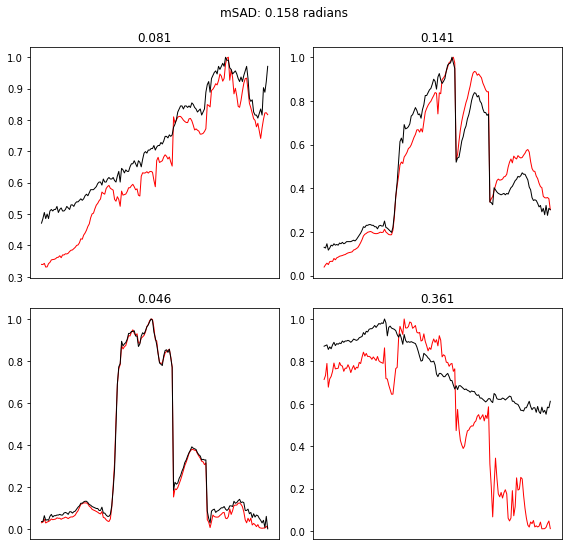

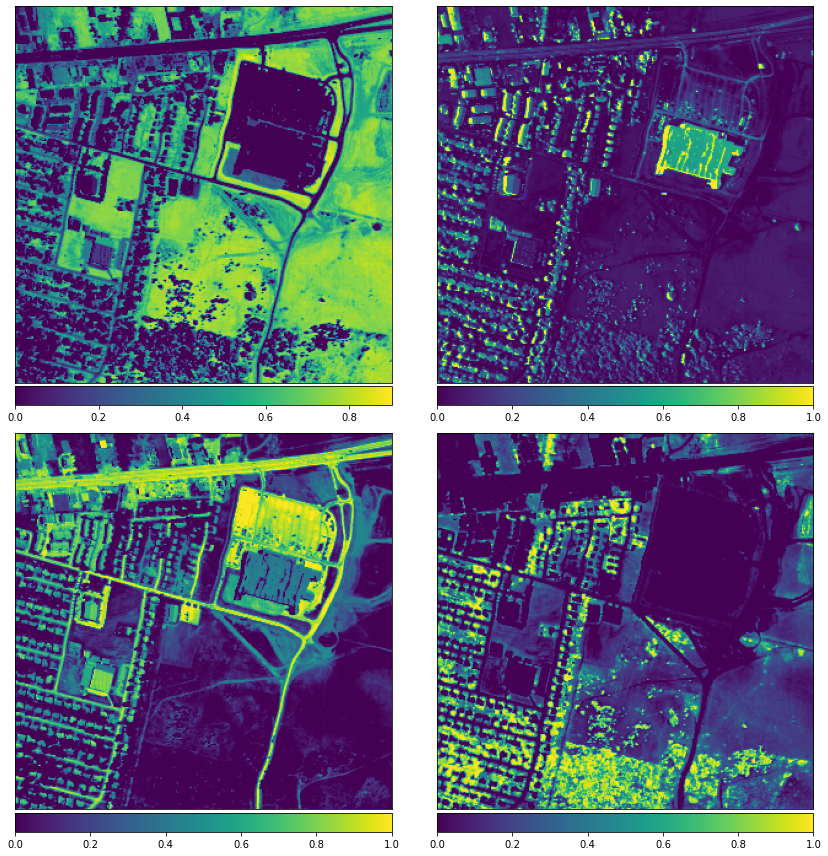

In [8]:
autoencoder = Autoencoder(params)
autoencoder.fit(training_data,plot_every)
endmembers = autoencoder.get_endmembers()
abundances = autoencoder.get_abundances()
plotEndmembersAndGT(endmembers, hsi.gt)
plotAbundancesSimple(abundances,'abund.png')


## Run experiment 

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.6617
Epoch 2/40
400/400 [==============================] - 1s 1ms/step - loss: 0.5063
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4386
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3829
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3777
Epoch 6/40
400/400 [==============================] - 0s 989us/step - loss: 0.3472
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3710
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3849
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3597
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3437
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3528
Epoch 12/40
400/400 [==============================] - 0s 984us/step - loss: 0.3575
Epoch 13/40
400/400 [

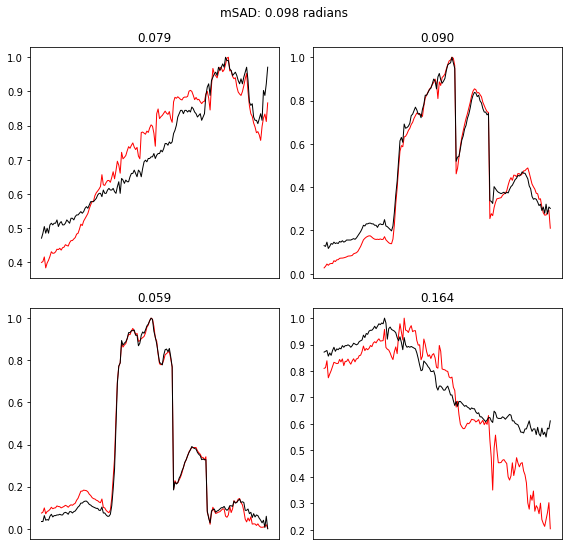

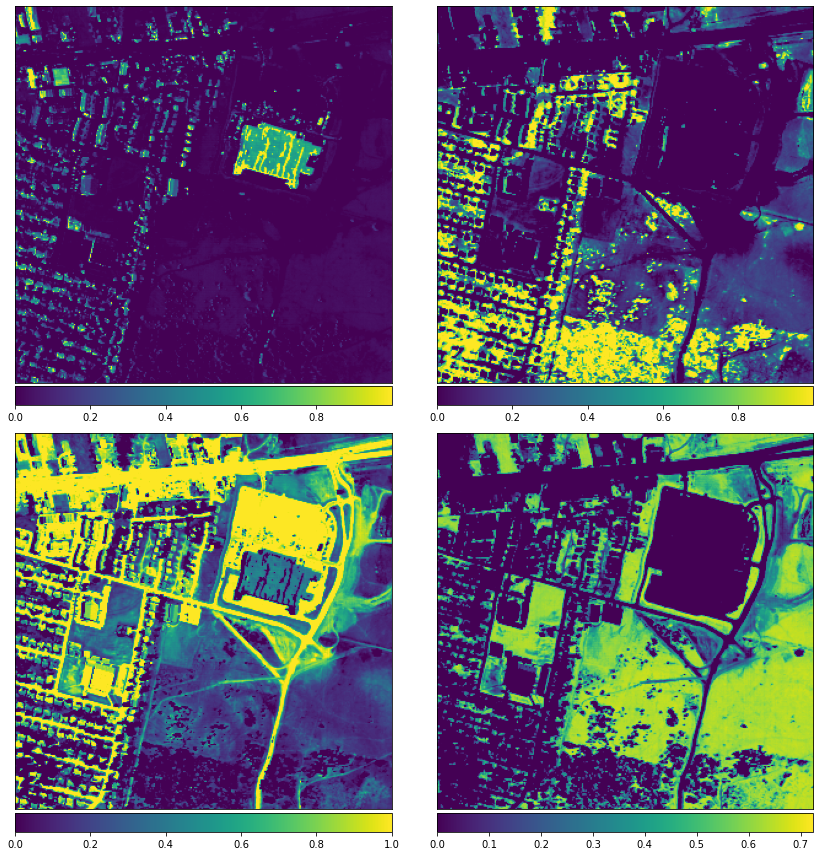

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.7911
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4854
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4117
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4010
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4036
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4038
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3936
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3836
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3653
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3663
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3759
Epoch 12/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4036
Epoch 13/40
400/400 [====

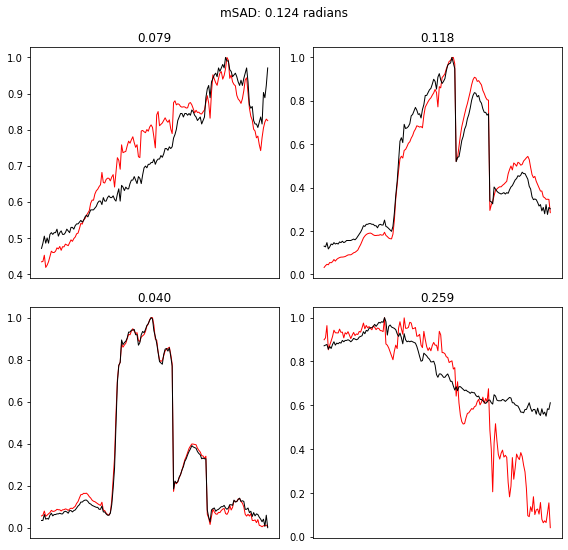

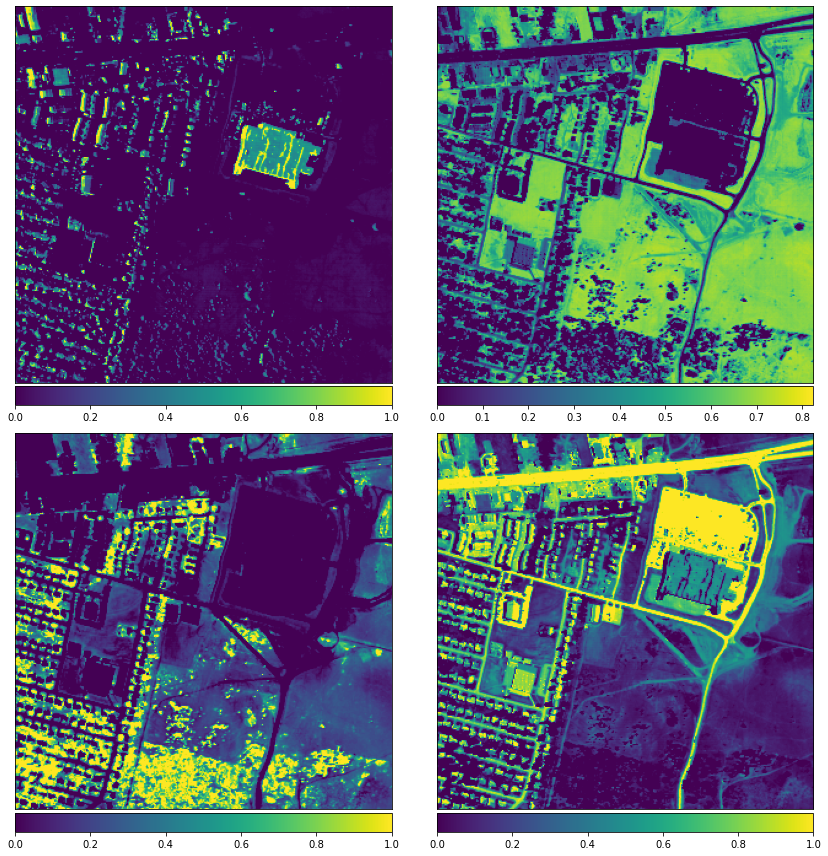

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.6464
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4402
Epoch 3/40
400/400 [==============================] - 0s 990us/step - loss: 0.3828
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3888
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3369
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3319
Epoch 7/40
400/400 [==============================] - 0s 990us/step - loss: 0.3497
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3683A: 0s - loss: 0.3
Epoch 9/40
400/400 [==============================] - 0s 991us/step - loss: 0.3294
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3396
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3529
Epoch 12/40
400/400 [==============================] - 0s 987us/step - loss: 0.3328


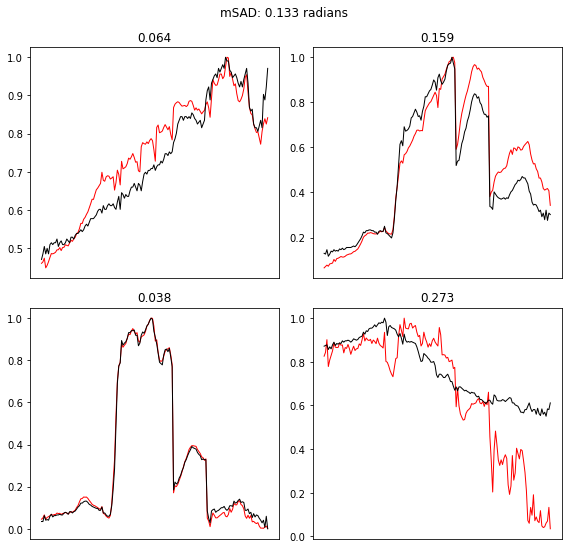

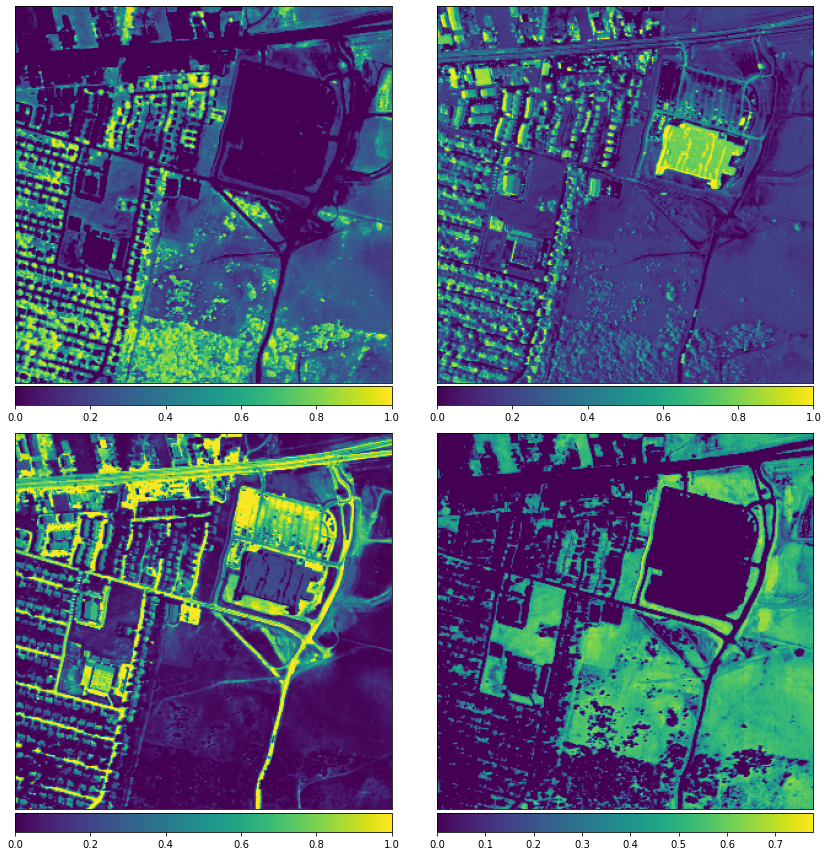

Epoch 1/40
400/400 [==============================] - 1s 992us/step - loss: 2.2944
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4734
Epoch 3/40
400/400 [==============================] - 0s 993us/step - loss: 0.4093
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4148
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3974
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3912
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3606
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3396
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3514
Epoch 10/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3693
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3522
Epoch 12/40
400/400 [==============================] - 0s 991us/step - loss: 0.3661
Epoch 13/40
400/400

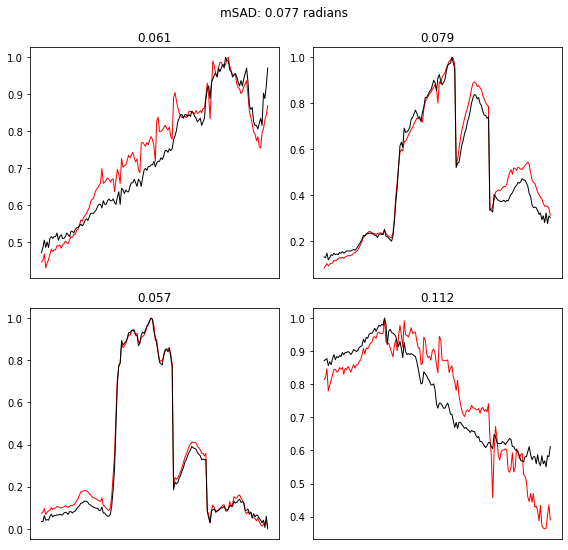

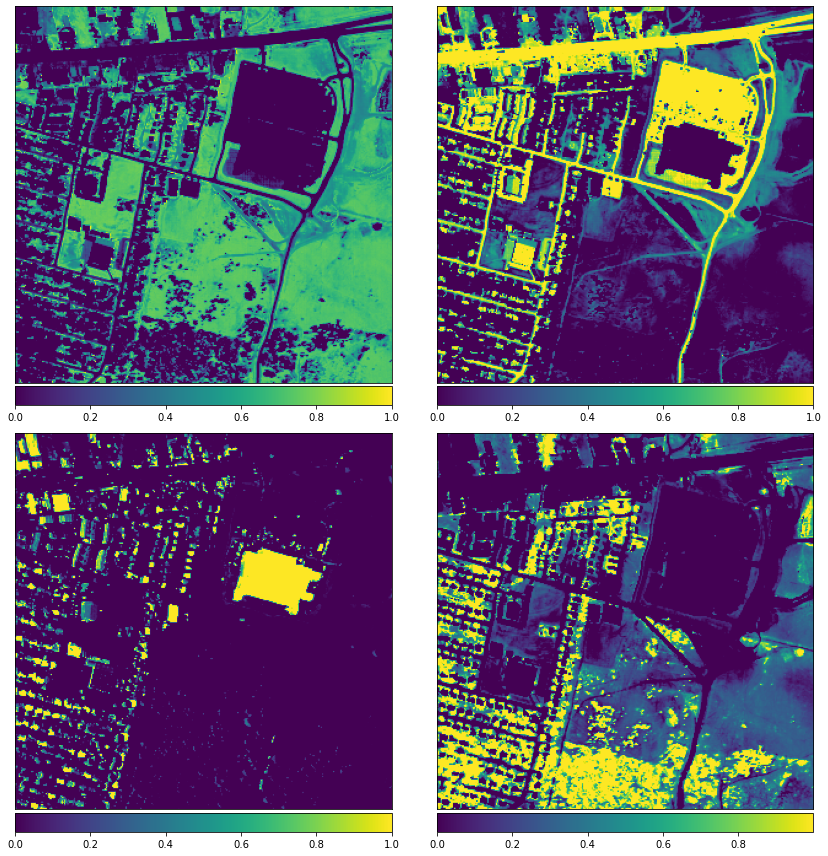

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.9827
Epoch 2/40
400/400 [==============================] - 0s 948us/step - loss: 0.6392
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4253
Epoch 4/40
400/400 [==============================] - 0s 940us/step - loss: 0.4051
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3804
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3611
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3417
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3738
Epoch 9/40
400/400 [==============================] - 0s 991us/step - loss: 0.3539
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3507
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3488
Epoch 12/40
400/400 [==============================] - 0s 990us/step - loss: 0.3608
Epoch 13/40
400/4

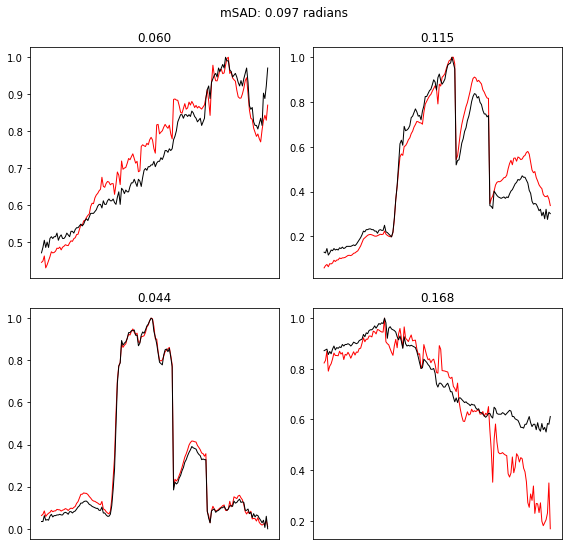

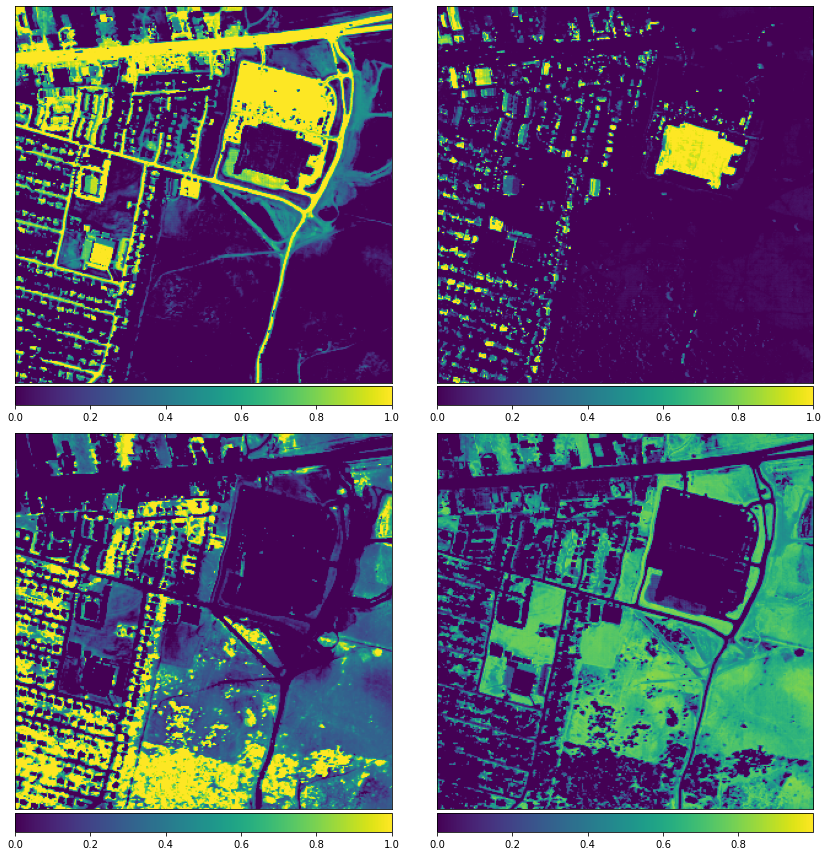

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.9573
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4775
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4294
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4368
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4186
Epoch 6/40
400/400 [==============================] - 0s 990us/step - loss: 0.3981
Epoch 7/40
400/400 [==============================] - 0s 990us/step - loss: 0.3948
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3915
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3706
Epoch 10/40
400/400 [==============================] - 0s 940us/step - loss: 0.3896
Epoch 11/40
400/400 [==============================] - 0s 991us/step - loss: 0.3778
Epoch 12/40
400/400 [==============================] - 0s 992us/step - loss: 0.3698
Epoch 13/40
400

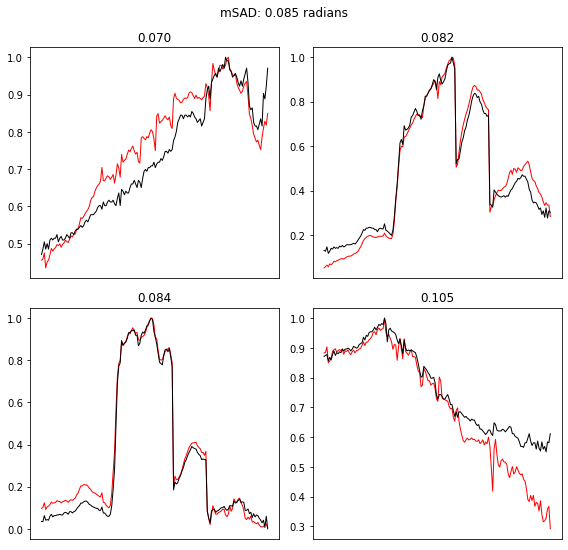

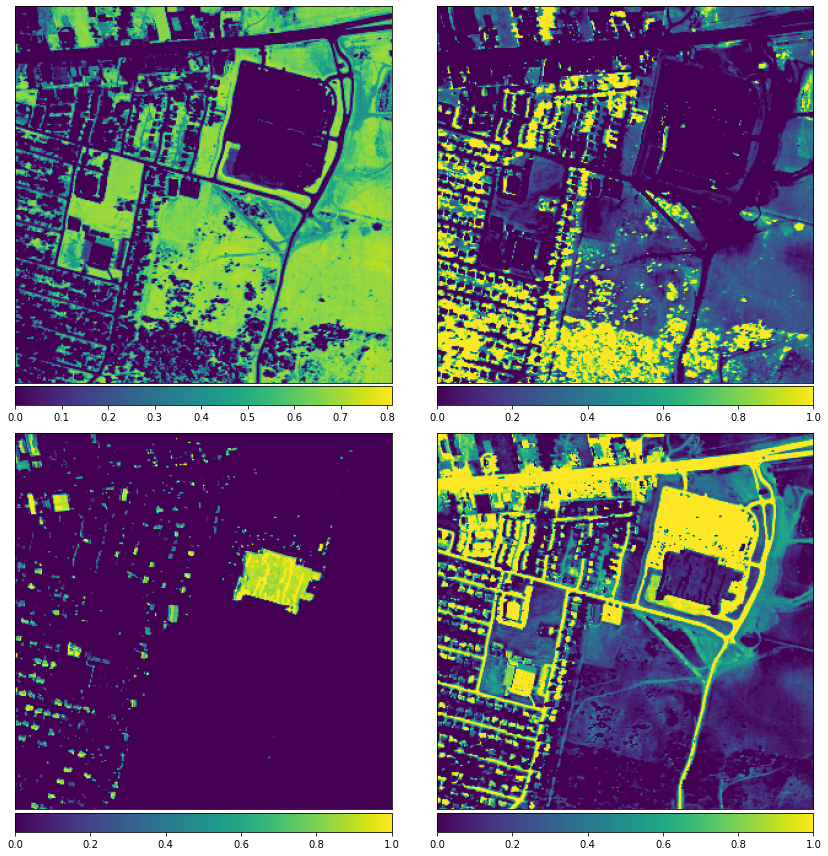

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.2044
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.6909
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3785
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3745
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3607
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3496
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3489
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3507
Epoch 9/40
400/400 [==============================] - 0s 953us/step - loss: 0.3448
Epoch 10/40
400/400 [==============================] - 1s 2ms/step - loss: 0.3285
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3247
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3017
Epoch 13/40
400/400 [==

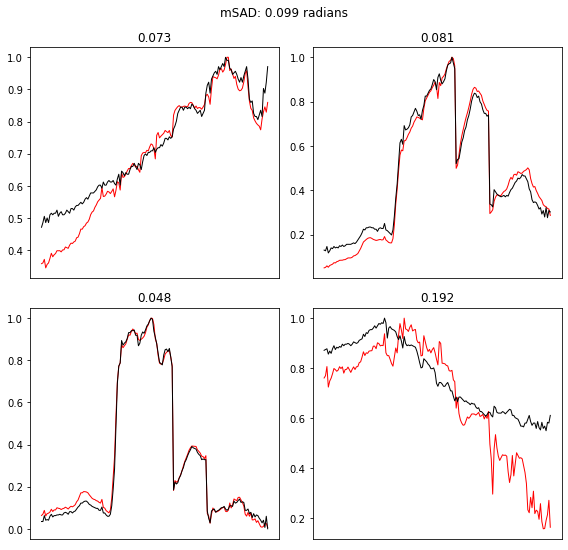

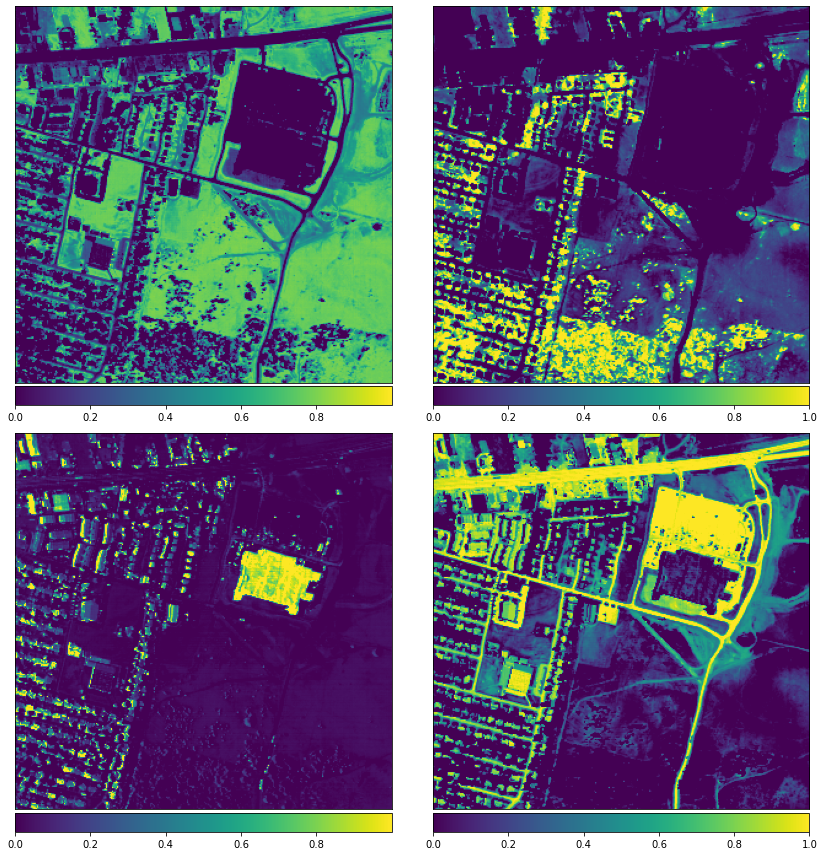

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.1439
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4897
Epoch 3/40
400/400 [==============================] - 0s 953us/step - loss: 0.4128
Epoch 4/40
400/400 [==============================] - 0s 991us/step - loss: 0.4028
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3926
Epoch 6/40
400/400 [==============================] - 0s 967us/step - loss: 0.3845
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3675
Epoch 8/40
400/400 [==============================] - 0s 989us/step - loss: 0.3771
Epoch 9/40
400/400 [==============================] - 0s 949us/step - loss: 0.3463
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3617
Epoch 11/40
400/400 [==============================] - 0s 935us/step - loss: 0.3692
Epoch 12/40
400/400 [==============================] - 0s 947us/step - loss: 0.3480
Epoch 13/40

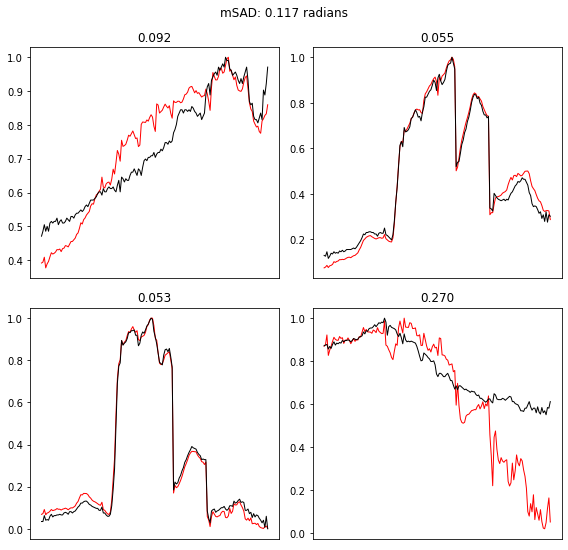

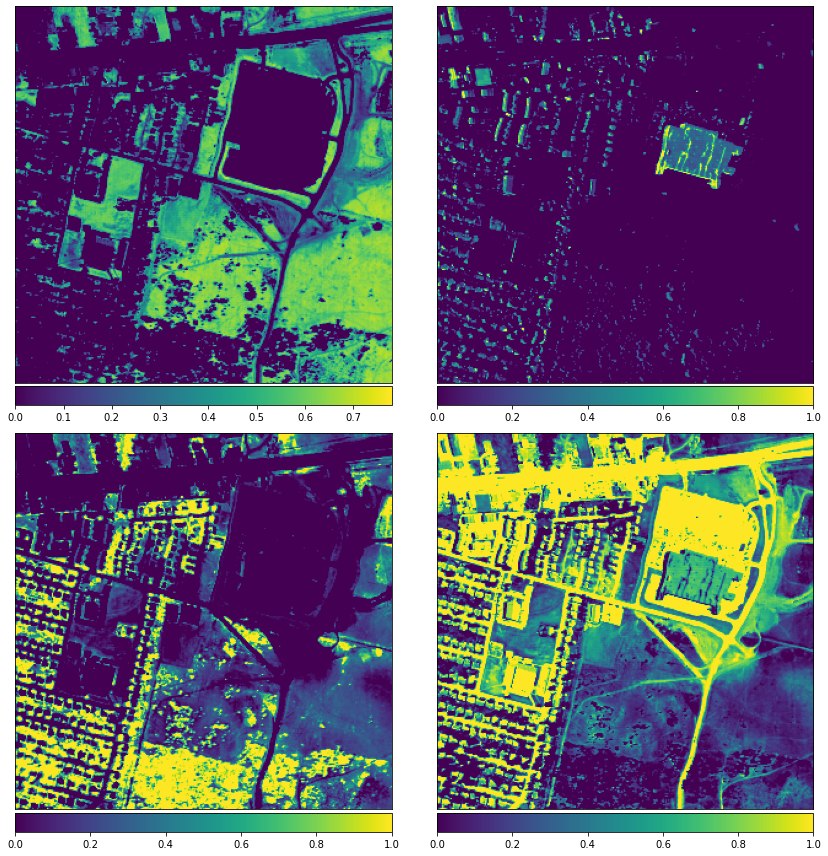

Epoch 1/40
400/400 [==============================] - 2s 1ms/step - loss: 3.0570
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4908
Epoch 3/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4301
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4374
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4393
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3999
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3770
Epoch 8/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3768
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3932
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3754
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3884
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3536
Epoch 13/40
400/400 [====

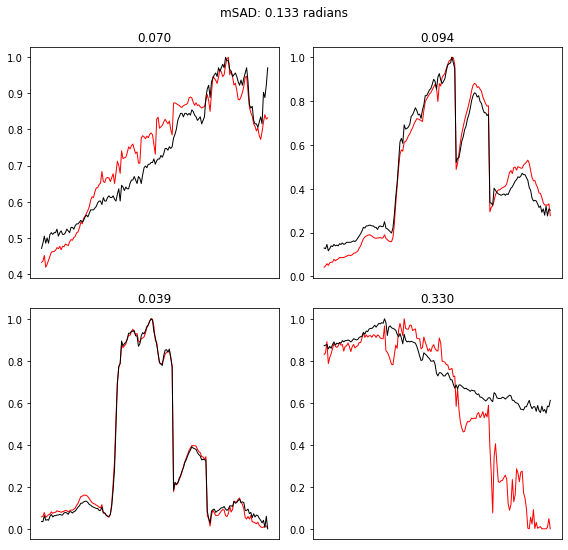

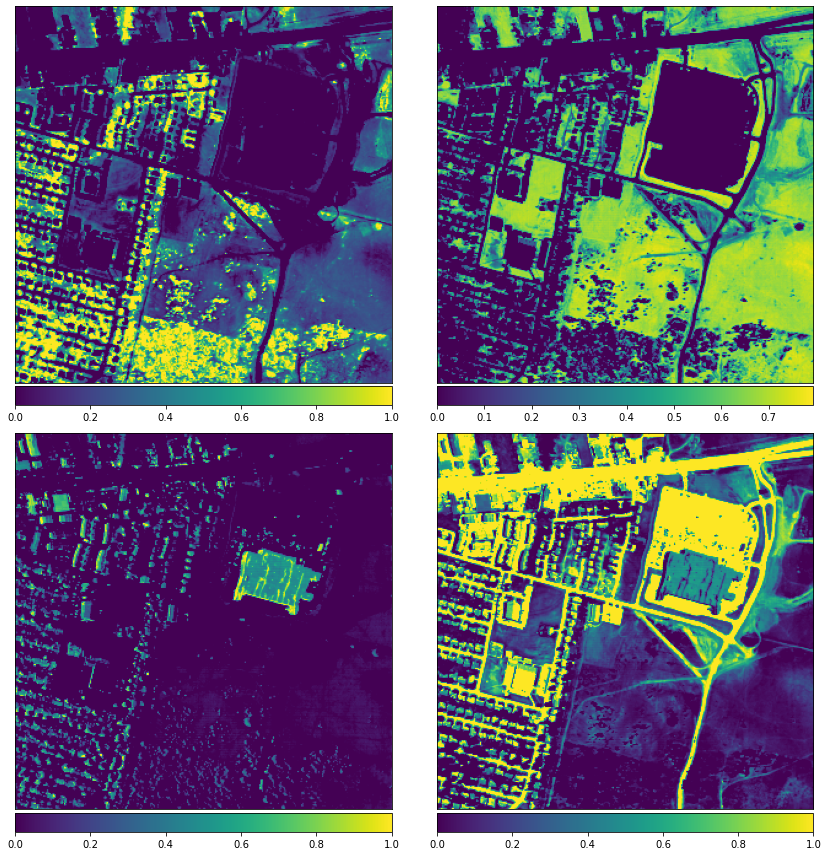

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.1233
Epoch 2/40
400/400 [==============================] - ETA: 0s - loss: 0.449 - 0s 1ms/step - loss: 0.4478
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3796
Epoch 4/40
400/400 [==============================] - 0s 991us/step - loss: 0.3717
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3624
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3652
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3670
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3625
Epoch 9/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3544
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3586
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3488
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3363

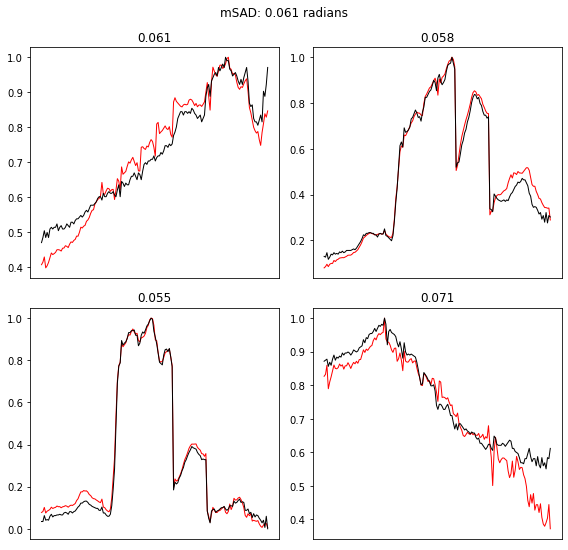

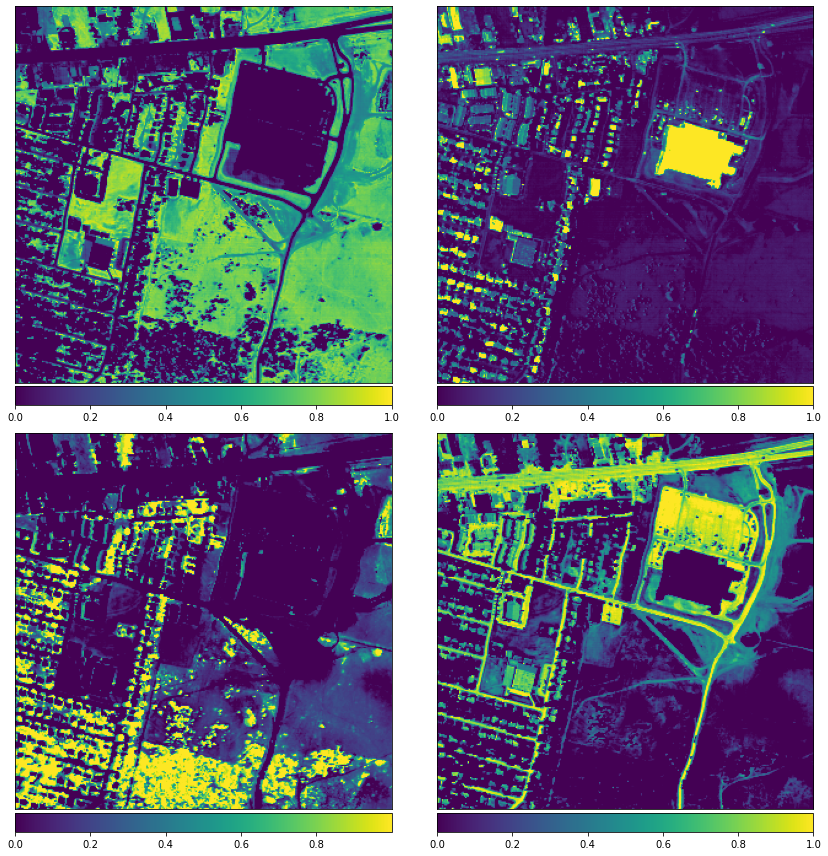

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.0779
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.6142
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4377
Epoch 4/40
400/400 [==============================] - 1s 2ms/step - loss: 0.4092
Epoch 5/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4220
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3971
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4135
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3693
Epoch 9/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4039
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3606
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3686
Epoch 12/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3843
Epoch 13/40
400/400 [====

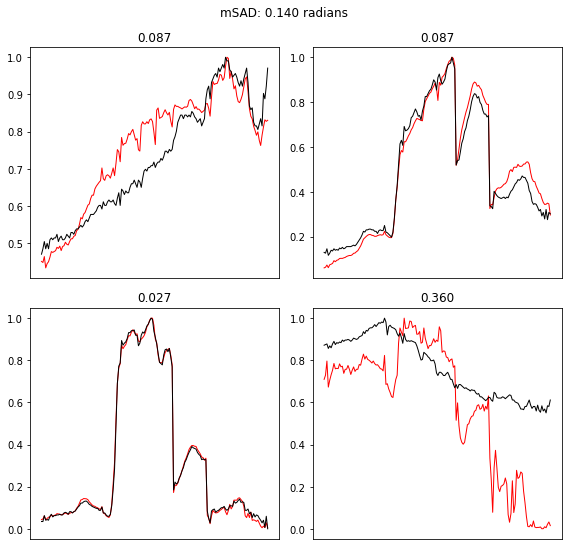

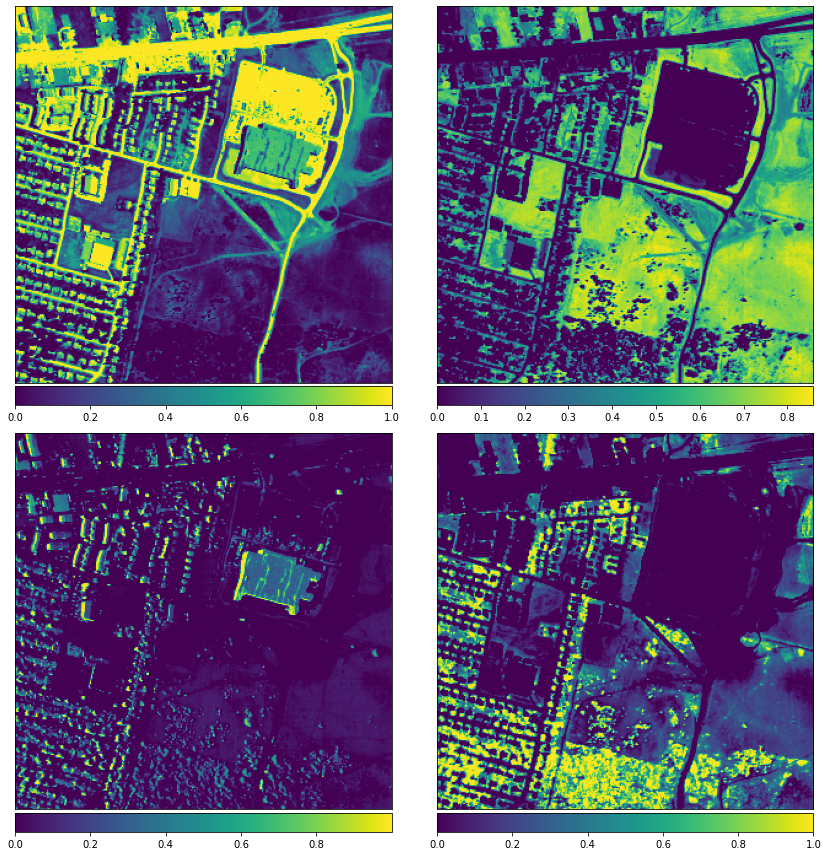

Epoch 1/40
400/400 [==============================] - 2s 2ms/step - loss: 2.5502
Epoch 2/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4437
Epoch 3/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4148
Epoch 4/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4276
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3986
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4062
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3791
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3736
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3717
Epoch 10/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3640
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3868
Epoch 12/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3903
Epoch 13/40
400/400 [====

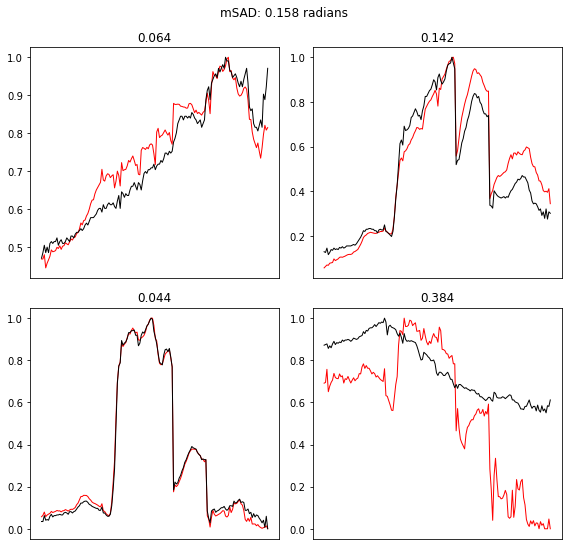

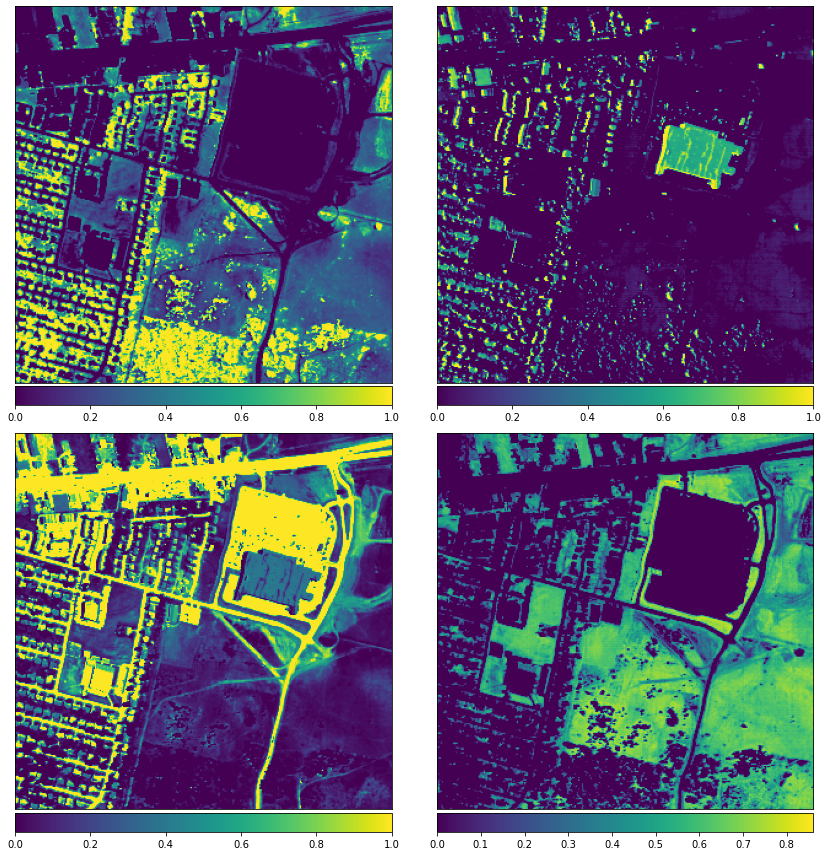

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.1789
Epoch 2/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4925
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4064
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3819
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3726
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3798
Epoch 7/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3580
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3406
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3580
Epoch 10/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3848
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3633
Epoch 12/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3582
Epoch 13/40
400/400 [====

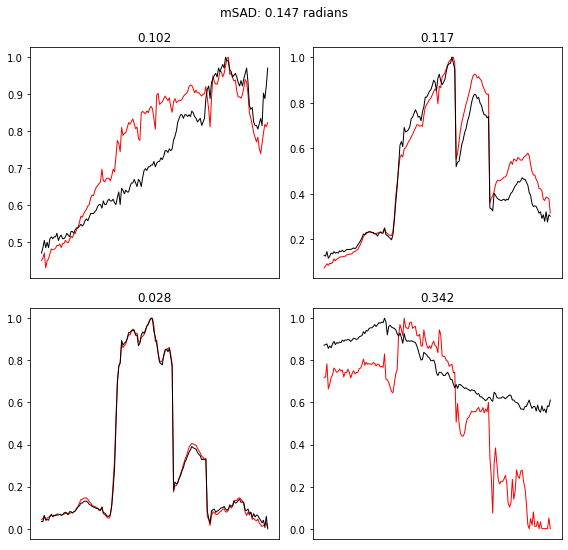

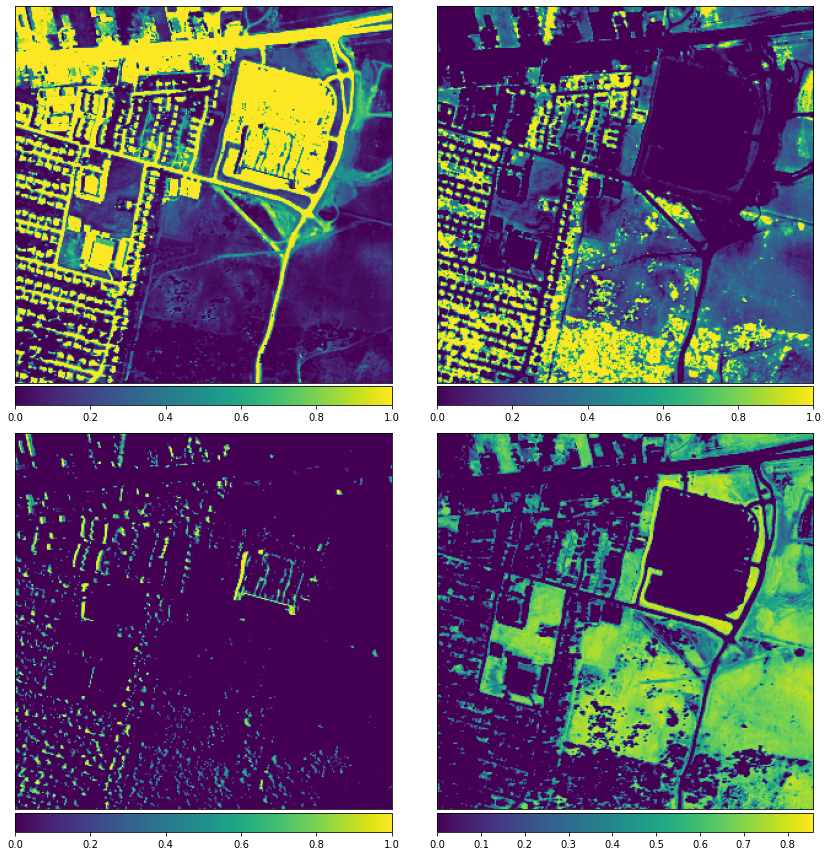

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.9344
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.5230
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4572
Epoch 4/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4256
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4137
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4315
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4306
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4050
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4020
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3888
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4102
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3802
Epoch 13/40
400/400 [====

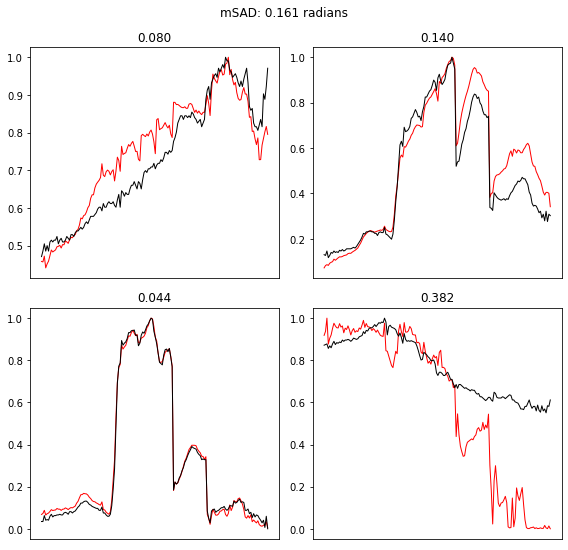

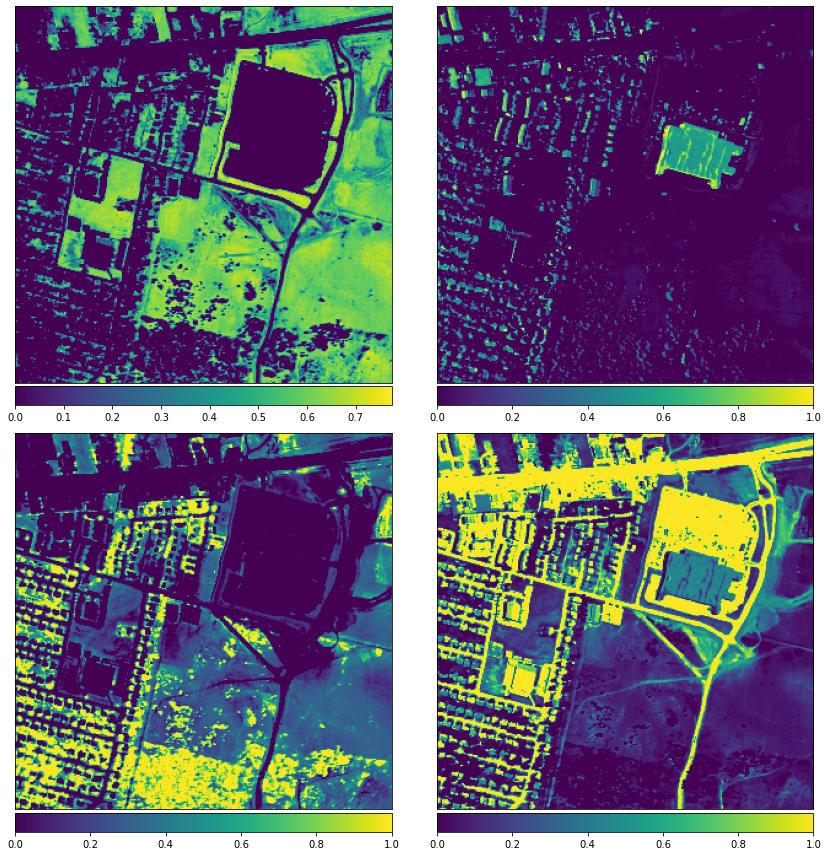

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.1052
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4556
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4507
Epoch 4/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4929
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4401
Epoch 6/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4532
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4117
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4206
Epoch 9/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4046
Epoch 10/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4084
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3869
Epoch 12/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3798
Epoch 13/40
400/400 [====

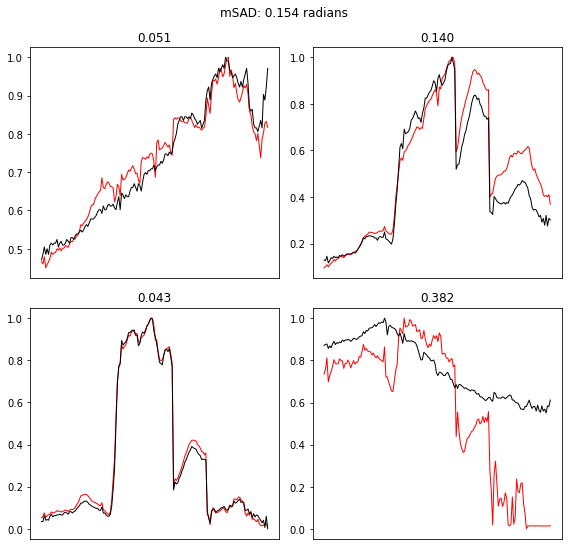

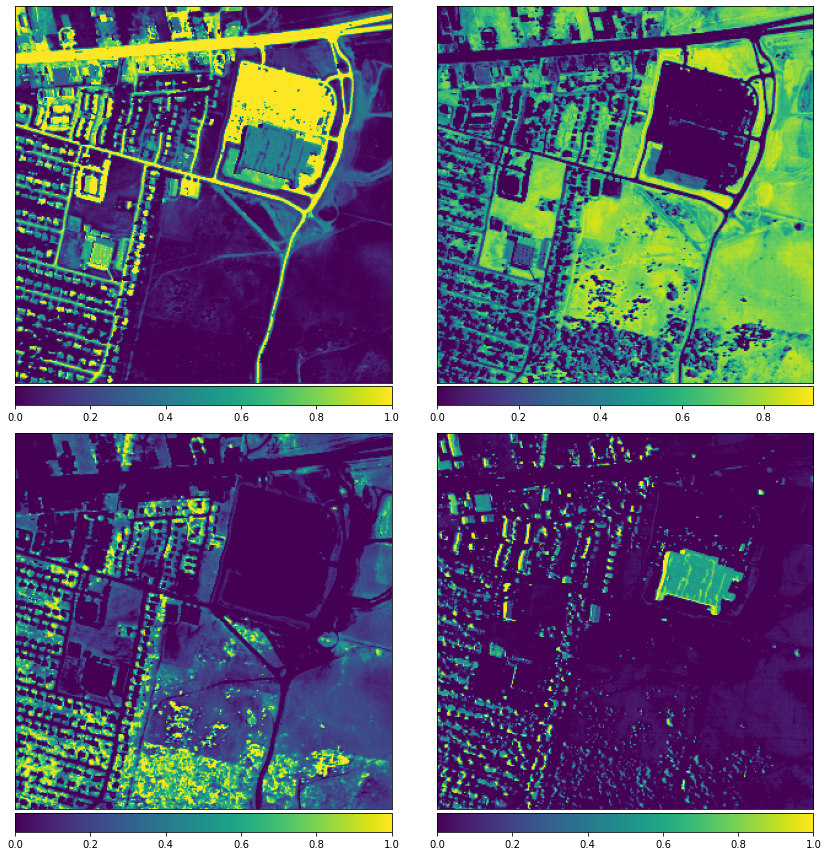

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.6129
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.5126
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4418
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4120
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4157
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3965
Epoch 7/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4570
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3943
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4147
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3644
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3428
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3412
Epoch 13/40
400/400 [====

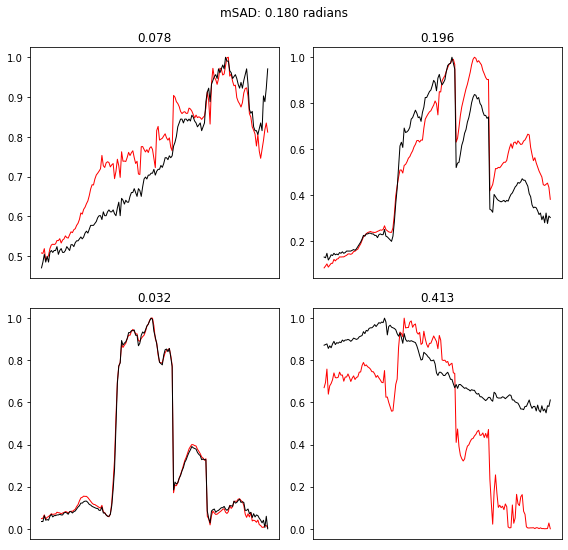

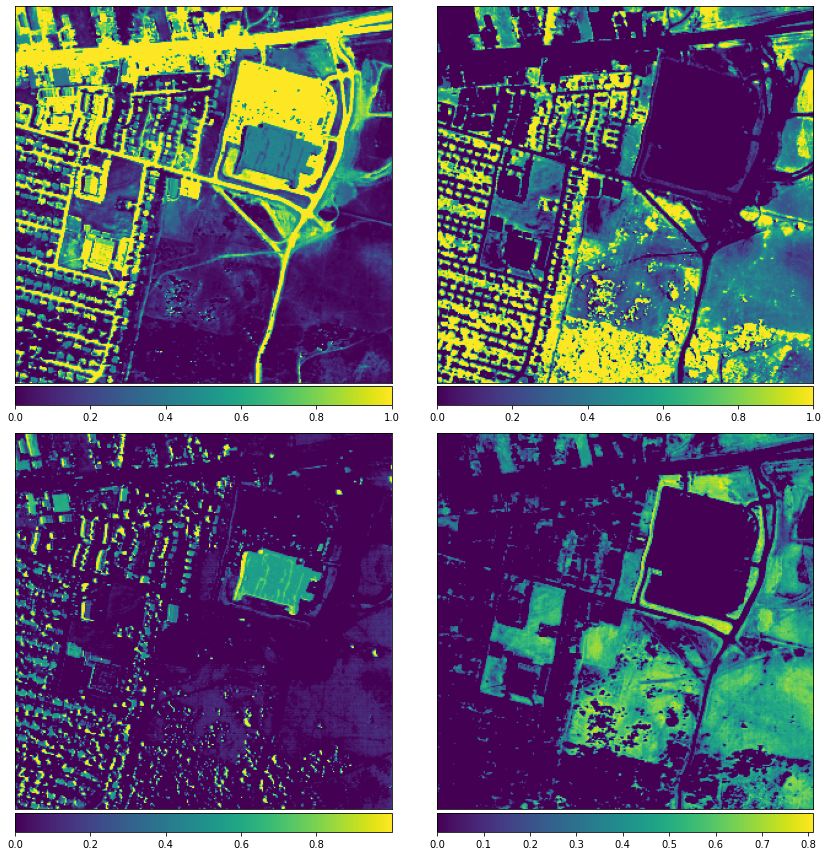

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.2848
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4529
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4307
Epoch 4/40
400/400 [==============================] - 0s 997us/step - loss: 0.3993
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3885
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3667
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3916
Epoch 8/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3592
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3879
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3480
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3444
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3394
Epoch 13/40
400/400 [==

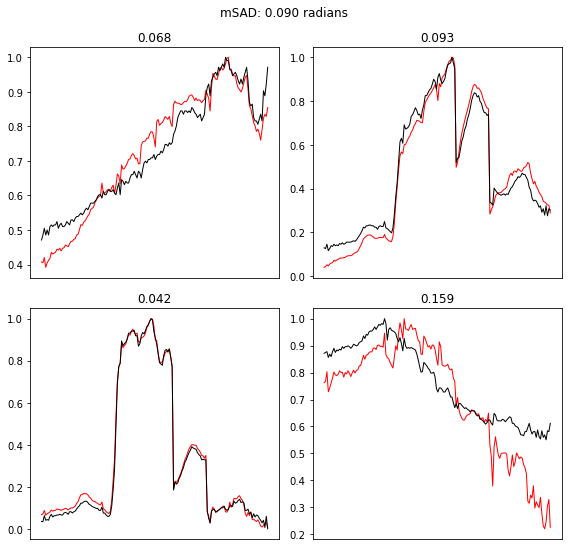

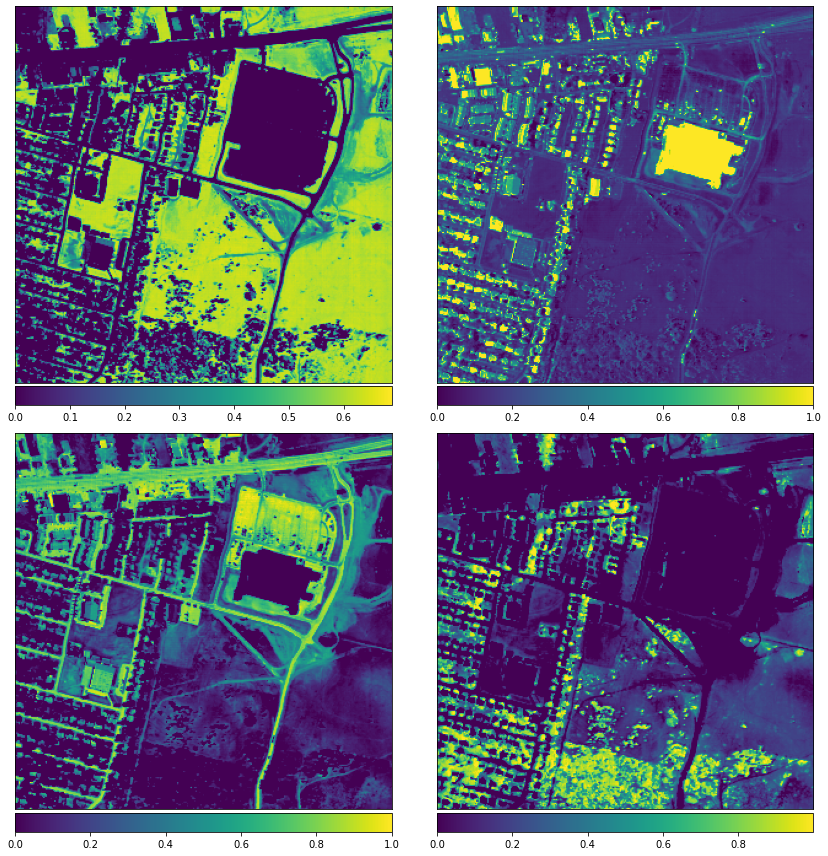

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.1681
Epoch 2/40
400/400 [==============================] - 1s 1ms/step - loss: 0.5304
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4545
Epoch 4/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4206
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3925
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3804
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3823
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3903
Epoch 9/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3643
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3800
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3324
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3996
Epoch 13/40
400/400 [====

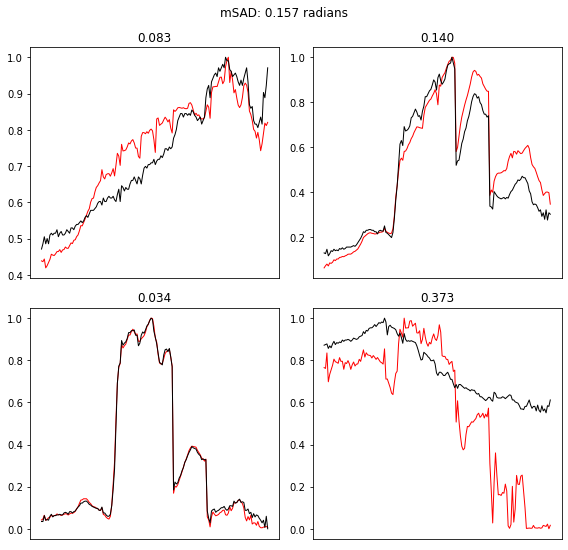

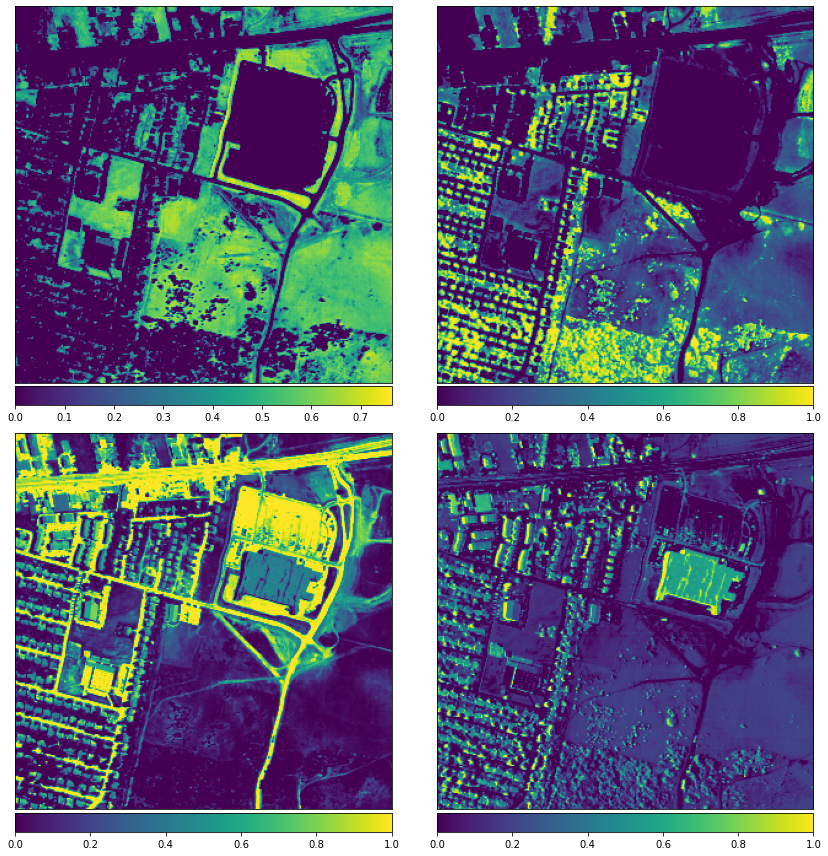

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.0918
Epoch 2/40
400/400 [==============================] - 1s 1ms/step - loss: 0.5258
Epoch 3/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4358
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4150
Epoch 5/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4225
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3735
Epoch 7/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3758
Epoch 8/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3578
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3812
Epoch 10/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3741
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3506
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3554
Epoch 13/40
400/400 [====

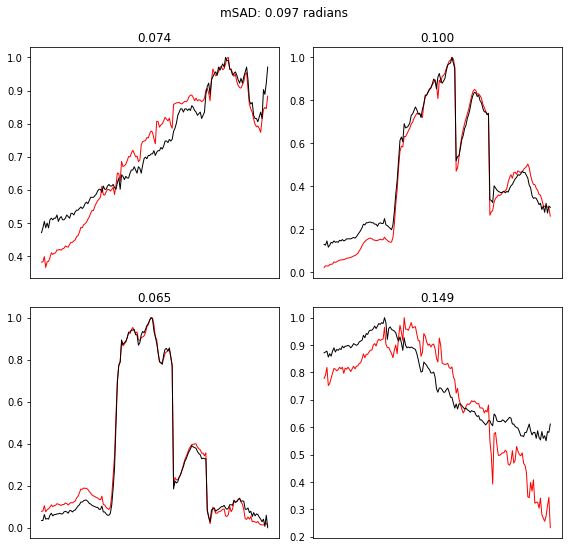

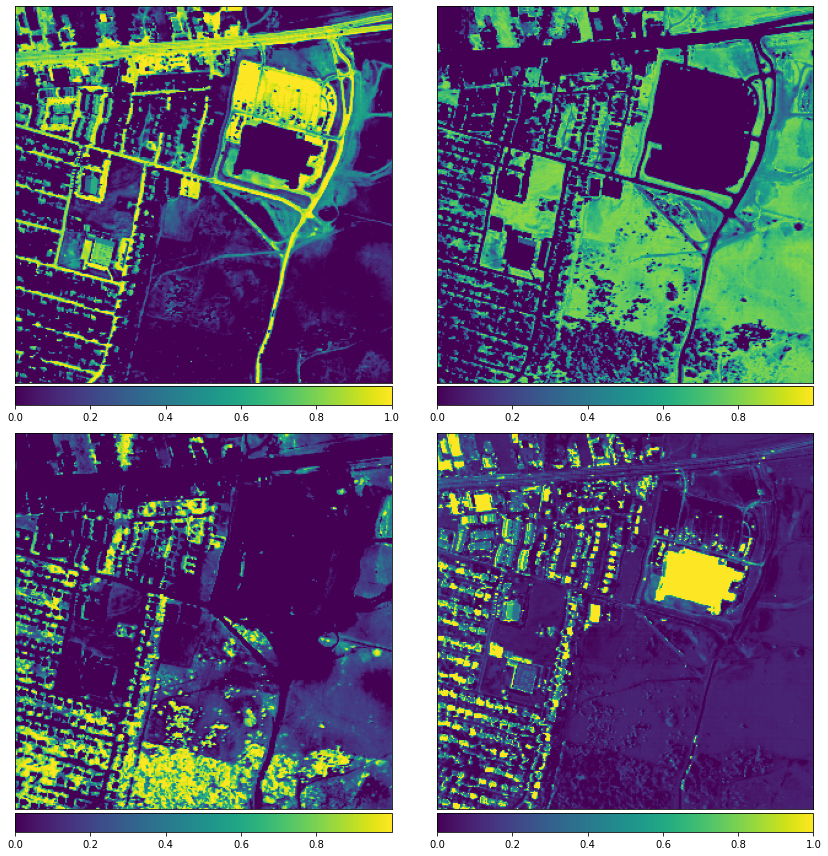

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.6780
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.9877
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4738
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4328
Epoch 5/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4229
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3955
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3856
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3812
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3775
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3846
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3705
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3733
Epoch 13/40
400/400 [====

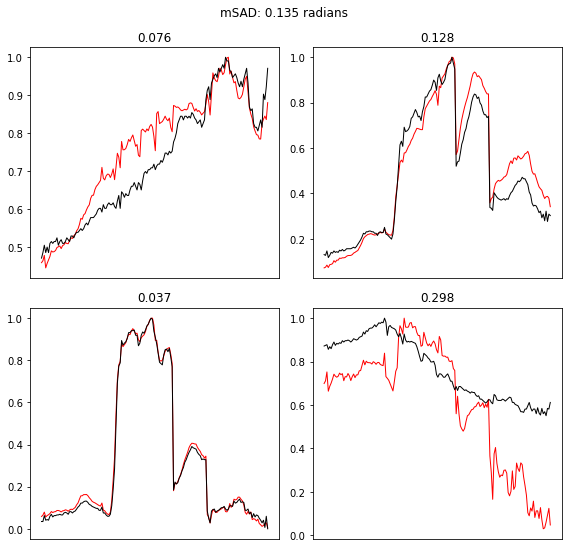

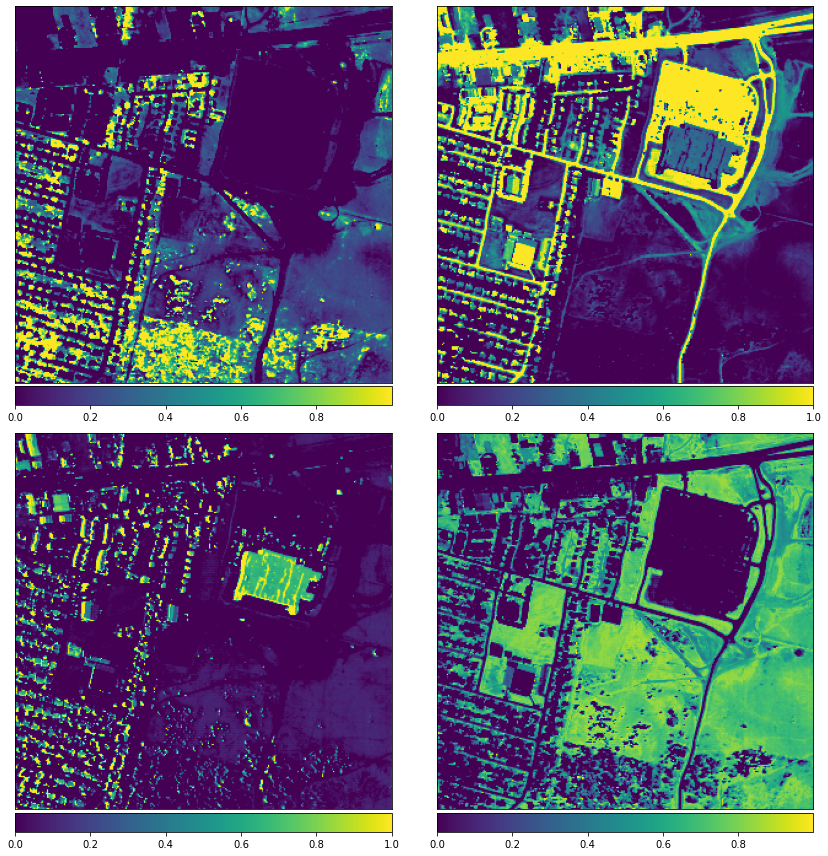

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.4031
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.8161
Epoch 3/40
400/400 [==============================] - 0s 988us/step - loss: 0.4401
Epoch 4/40
400/400 [==============================] - 0s 988us/step - loss: 0.4134
Epoch 5/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3826
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3770
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3463
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3376
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3738
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3414
Epoch 11/40
400/400 [==============================] - 0s 989us/step - loss: 0.3449
Epoch 12/40
400/400 [==============================] - 0s 987us/step - loss: 0.3161
Epoch 13/40
400/4

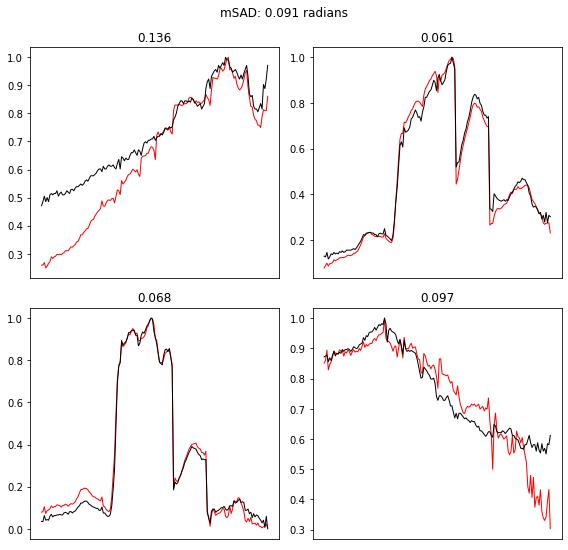

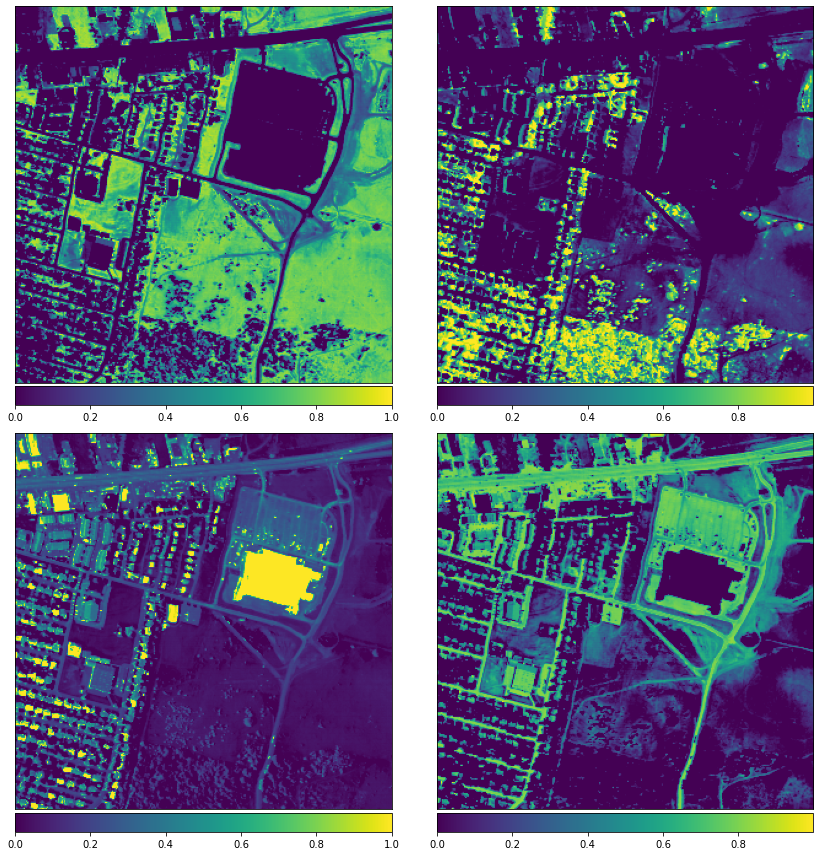

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.9369
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.5344
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4421
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4117
Epoch 5/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4383
Epoch 6/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3993
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4222
Epoch 8/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4191
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3927
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3830
Epoch 11/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3610
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3867
Epoch 13/40
400/400 [====

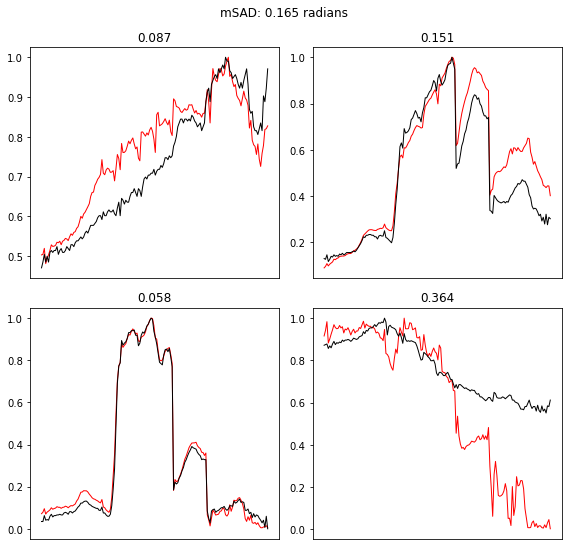

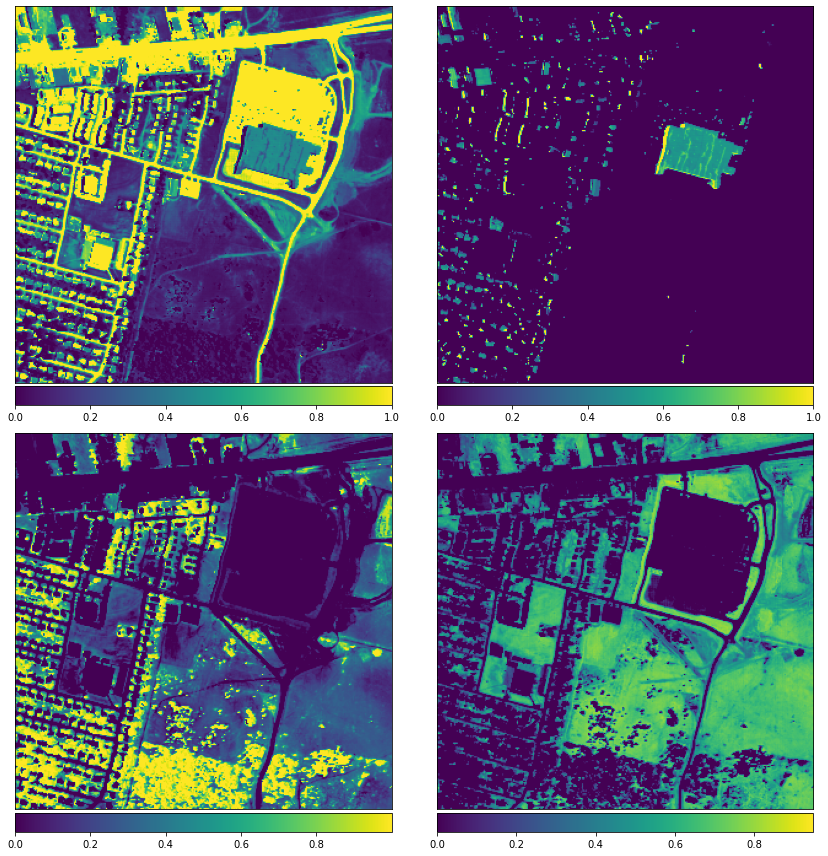

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.8343
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.5235
Epoch 3/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3997
Epoch 4/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3815
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3817
Epoch 6/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3484
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3230
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3580
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3276
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3248
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3333
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3261
Epoch 13/40
400/400 [====

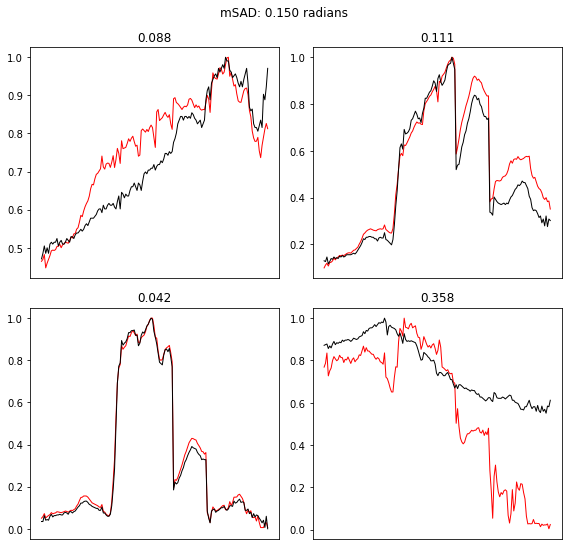

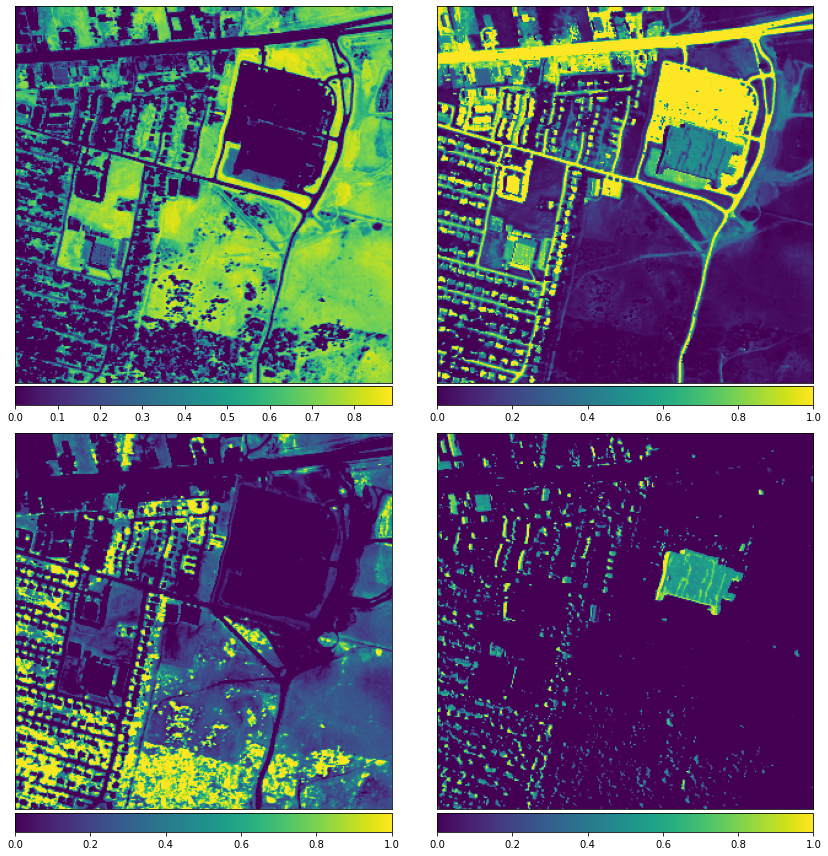

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 2.3708
Epoch 2/40
400/400 [==============================] - 0s 1ms/step - loss: 0.4507
Epoch 3/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4176
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3816
Epoch 5/40
400/400 [==============================] - 0s 990us/step - loss: 0.3788
Epoch 6/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3688
Epoch 7/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3758
Epoch 8/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3698
Epoch 9/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3625
Epoch 10/40
400/400 [==============================] - 1s 1ms/step - loss: 0.3449
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3568
Epoch 12/40
400/400 [==============================] - 1s 2ms/step - loss: 0.3680
Epoch 13/40
400/400 [==

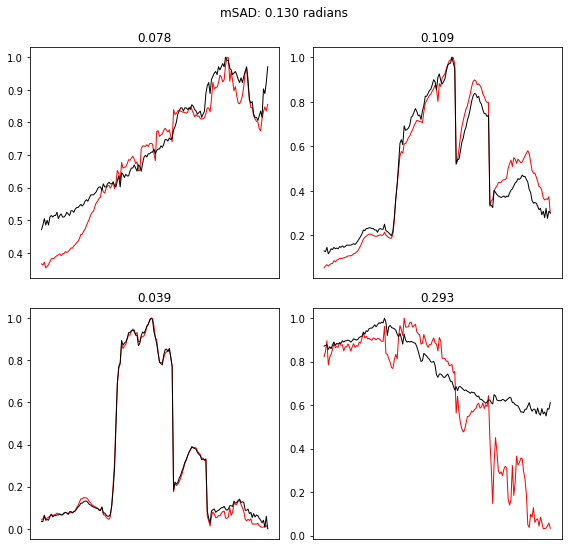

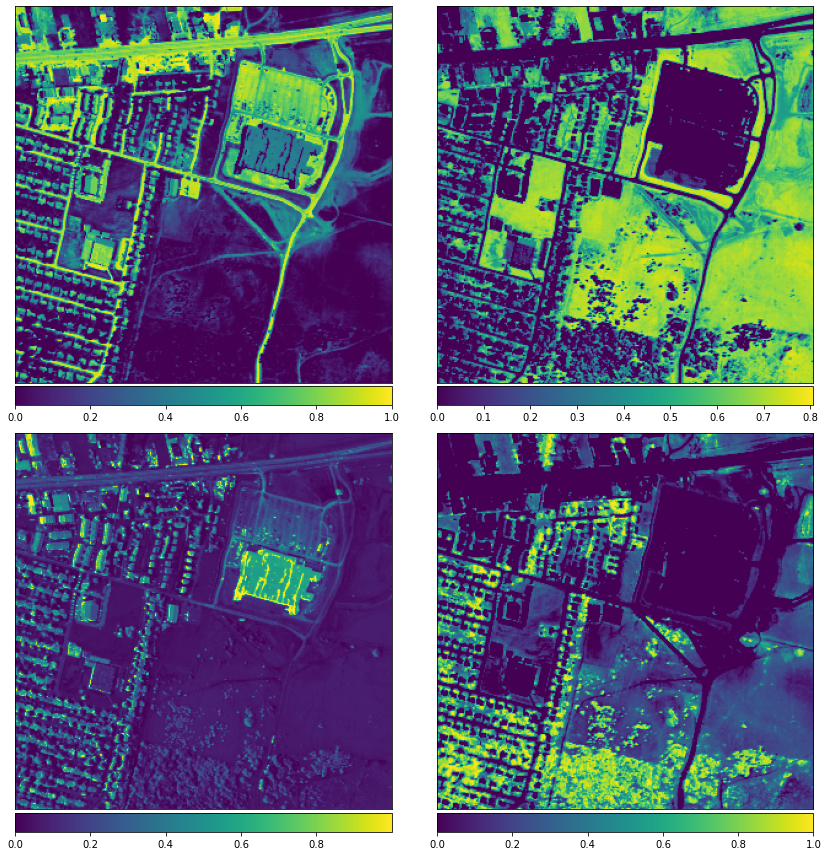

Epoch 1/40
400/400 [==============================] - 1s 1ms/step - loss: 1.8382
Epoch 2/40
400/400 [==============================] - 1s 1ms/step - loss: 0.4261
Epoch 3/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3994
Epoch 4/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3696
Epoch 5/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3610
Epoch 6/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3777
Epoch 7/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3747
Epoch 8/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3752
Epoch 9/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3326
Epoch 10/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3536
Epoch 11/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3347
Epoch 12/40
400/400 [==============================] - 0s 1ms/step - loss: 0.3395
Epoch 13/40
400/400 [====

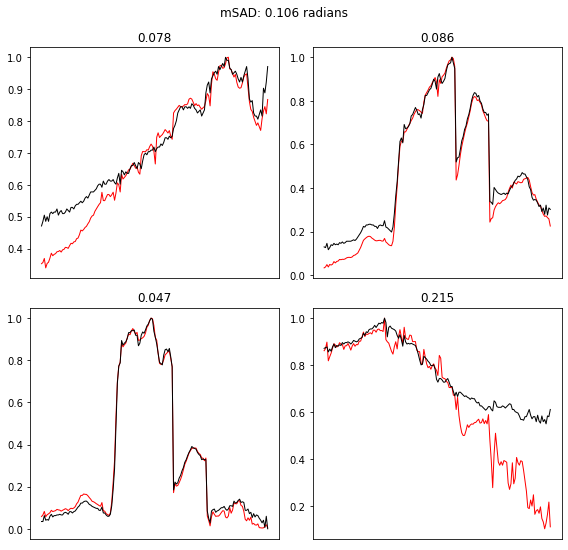

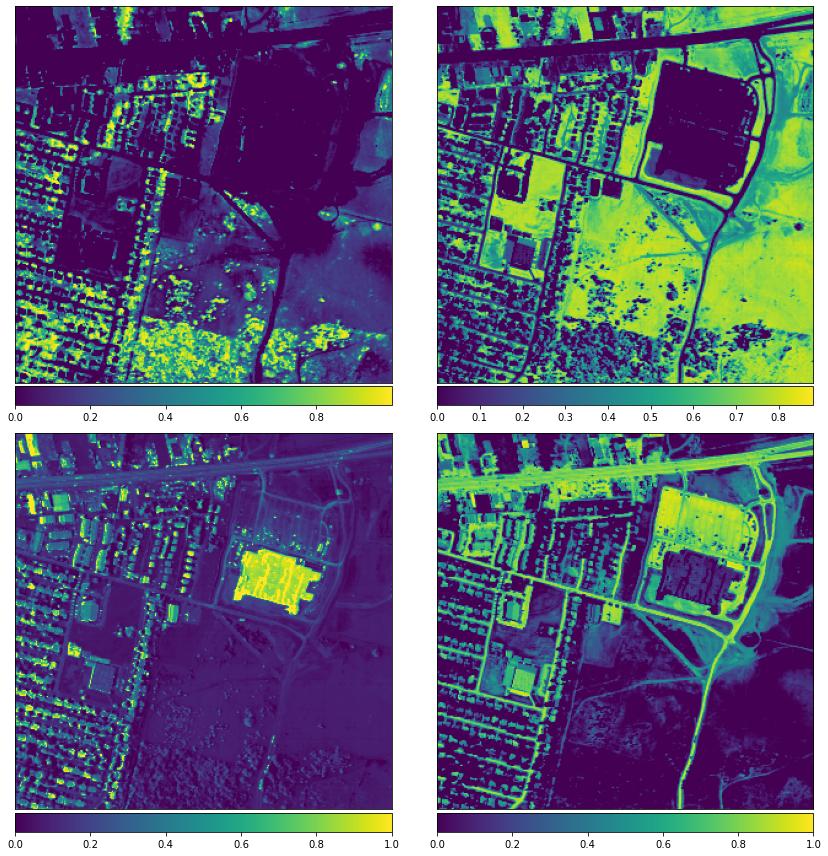

In [9]:
num_runs = 25
plot_every = 0 #Plot endmembers and abundance maps every x epochs. Set to 0 when running experiments. 

results_folder = './Results6'

method_name = 'SIDAEU'

for dataset in ['Urban']:
    save_folder = results_folder+'/'+method_name+'/'+dataset
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)

    hsi = load_HSI(
        datasetnames[dataset] + ".mat"
    )
    data=hsi.array()
    batch_size = 256
    params['data']=hsi
    params['n_bands']=hsi.bands

    for run in range(1,num_runs+1):
        training_data = data[np.random.randint(0, data.shape[0], num_spectra), :]
        save_name = dataset+'_run'+str(run)+'.mat'
        save_path = save_folder+'/'+save_name
        autoencoder = Autoencoder(params)
        autoencoder.fit(training_data,plot_every)
        endmembers = autoencoder.get_endmembers()
        abundances = autoencoder.get_abundances()
        plotEndmembersAndGT(endmembers, hsi.gt)
        plotAbundancesSimple(abundances,'abund.png')
        sio.savemat(save_path,{'M':endmembers,'A':abundances})
        del autoencoder